## Chapter 9
# Composition and Methodology

**_NOTE: all compositional algorithms presented here are adapted from the examples in Musimathics Vol 1 Chapter 9. The original code is written in the [Musimat language](http://www.musimat.com/), and is adated here to Python (using helper methods that can be found in the main `musimathics` directory one level down from this notebook._**

In [1]:
import sys
sys.path.append('../')

import numpy as np
from Note import Note
from NoteSequence import NoteSequence, render_notes_ipython
from pitches import FREQUENCY_FOR_NOTE_LABEL
F = FREQUENCY_FOR_NOTE_LABEL # alias for brevity

## Guido's Method

Guido's method was developed around 1026 by the music theoretician Guido d'Arezzo to aid in teaching his students composition.

He constructed a table of correspondences between the notes of the scale and the vowels in the Latin text that was to be set to music.  He laid out the pitches of the double octave and mapped three iterations of the vowel sequence a e i o u.

Guido then selected a Latin text, extracted the vowels from each word, and looked up corresponding pitch values from his table.  Since the method provides three chioces for each vowel (and four choices for a), the method requires using subjective judgement to select from the options.

Below we select among the set of choices for each note randomly.

In [2]:
guido_note_labels = ['G3', 'A3', 'B3', 'C4', 'D4', 'E4', 'F4', 'G4', 'A4', 'B4', 'C5', 'D5', 'E5', 'F5', 'G5']

vowels = list('aeiou')

def guido(text):
    generated_note_labels = []
    for character in text:
        if character in vowels:
            offset = vowels.index(character)
            r = np.random.randint(len(guido_note_labels) // len(vowels))
            n = (len(vowels) * r) + offset
            generated_note_labels.append(guido_note_labels[n])
    return generated_note_labels

Notes generated with Guido's method:

In [3]:
guido_generated_note_labels = guido('Ut queant laxis resonare.')
guido_generated_note_labels

['D4', 'D5', 'C5', 'G3', 'G4', 'D5', 'F5', 'E4', 'F4']

In [4]:
render_notes_ipython(guido_generated_note_labels)

Another possibility for Guido-generated notes of the same text:

In [5]:
guido_generated_note_labels = guido('Ut queant laxis resonare.')
guido_generated_note_labels

['B4', 'A3', 'C5', 'G3', 'G4', 'A3', 'A4', 'C5', 'F4']

In [6]:
render_notes_ipython(guido_generated_note_labels)

## Pseudorandomness

### Linear Congruential Method

In [7]:
class LinearCongruentialMethod:
    def __init__(self, seed=1, a=16807, b=0, c=2147483647):
        self.x = seed
        self.a = a
        self.b = b
        self.c = c
    
    def random_float(self, low=0.0, high=1.0):
        r = float(self._next())
        r /= float(self.c)
        return r * (high - low) + low

    def random_int(self, low=0, high=2147483647):
        return int(self.random_float(low, high + 1.0))

    def _next(self):
        self.x = (self.a * self.x + self.b) %  self.c
        return abs(self.x)

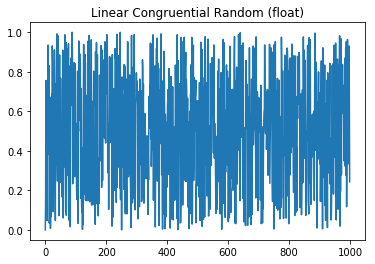

In [8]:
import matplotlib.pyplot as plt

%matplotlib inline

lc = LinearCongruentialMethod()
plt.title('Linear Congruential Random (float)')
plt.plot([lc.random_float() for _ in range(1000)])

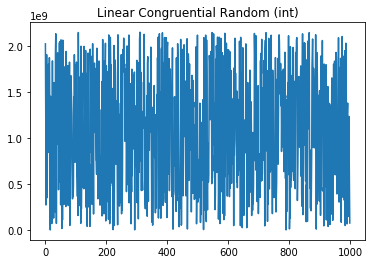

In [9]:
plt.title('Linear Congruential Random (int)')
plt.plot([lc.random_int() for _ in range(1000)])

## Composing Functions

### Precomposition

In [10]:
from pitches import SEMITONES_IN_OCTAVE

# takes single value or numpy array of pitch numbers
def transpose_pitch_numbers(pitch_numbers, semitones, in_scale=False):
    transposed = pitch_numbers + semitones
    return transposed % SEMITONES_IN_OCTAVE if in_scale else transposed

# takes single value or numpy array of pitch numbers
def invert_pitch_numbers(pitch_numbers):
    return (SEMITONES_IN_OCTAVE - pitch_numbers) % SEMITONES_IN_OCTAVE

# synonym for `reverse`
def retrograde_pitch_numbers(pitch_numbers):
    return pitch_numbers[-1::-1]

### The Set Complex

We create a matrix containing the prime form, inverse, retrograde, and all transpositions of any row - called the _set complex_.  The purpose of these transformations is to generate variants that are related to the original intervallic structure of the prime row, to be used as material in developing compositions.

In [11]:
def set_complex(prime_pitch_numbers):
    n = len(prime_pitch_numbers)
    set_complex = np.ndarray((n, n), dtype='int')
    inverted_pitch_numbers = invert_pitch_numbers(prime_pitch_numbers)
    for i in range(n):
        set_complex[0,i] = prime_pitch_numbers[i]
        set_complex[i,0] = inverted_pitch_numbers[i]
    for i in range(n):
        for j in range(n):
            set_complex[i,j] = (set_complex[i,0] + set_complex[0,j]) % n
    return set_complex

In [12]:
from pitches import PITCH_NUMBER_FOR_NOTE_LABEL
schoenberg_op_23_5_prime_set = np.array([0,8,10,6,7,5,9,1,3,2,11,4], dtype='int') # example from p320
schoenberg_op_23_5_set_complex = set_complex(schoenberg_op_23_5_prime_set)
schoenberg_op_23_5_set_complex

array([[ 0,  8, 10,  6,  7,  5,  9,  1,  3,  2, 11,  4],
       [ 4,  0,  2, 10, 11,  9,  1,  5,  7,  6,  3,  8],
       [ 2, 10,  0,  8,  9,  7, 11,  3,  5,  4,  1,  6],
       [ 6,  2,  4,  0,  1, 11,  3,  7,  9,  8,  5, 10],
       [ 5,  1,  3, 11,  0, 10,  2,  6,  8,  7,  4,  9],
       [ 7,  3,  5,  1,  2,  0,  4,  8, 10,  9,  6, 11],
       [ 3, 11,  1,  9, 10,  8,  0,  4,  6,  5,  2,  7],
       [11,  7,  9,  5,  6,  4,  8,  0,  2,  1, 10,  3],
       [ 9,  5,  7,  3,  4,  2,  6, 10,  0, 11,  8,  1],
       [10,  6,  8,  4,  5,  3,  7, 11,  1,  0,  9,  2],
       [ 1,  9, 11,  7,  8,  6, 10,  2,  4,  3,  0,  5],
       [ 8,  4,  6,  2,  3,  1,  5,  9, 11, 10,  7,  0]])

## Traversing and Manipulating Musical Materials

Following are a few ways rows can be traversed to structure tonal or atonal melodies, rhythms, dynamics, articulation, instrumentation, or anything else that can be parameterized.

In [13]:
# taking a more object-oriented approach than the book
class Position:
    def __init__(self, start_position=0):
        self.position = start_position
        self.current_increment_direction = 1
        self.permute_count = 0

    def get(self):
        return self.position

    def increment(self, by, max_position):
        self.position += by
        self.position %= max_position

    def cycle_select(self, items, increment_by):
        item = items[self.position]
        self.increment(increment_by, len(items))
        return item

    # "even" palindromes repeated the end element twice.
    # otherwise the palindrome is "odd" (no repeated end element)
    def palindrome_select(self, items, increment_by_abs, even=True):
        item = items[self.position]
        increment_by = abs(increment_by_abs) * self.current_increment_direction
        new_position = self.position + increment_by
        if new_position < 0 or new_position >= len(items):
            self.current_increment_direction *= -1
            increment_by *= -1
            if not even:
                self.increment(increment_by, len(items))
        else:
            self.increment(increment_by, len(items))
        return item
    
    # Iterate the supplied sequence in order until exhausted,
    # then permute the entire row by `permute_increment` steps
    # and repeat from the beginning.
    def permute_select(self, items, permute_increment):
        current_position = self.position
        item = self.cycle_select(items, 1)
        self.permute_count += 1
        if self.permute_count == len(items):
            self.permute_count = 0
            self.position = current_position + permute_increment
        return item

In [14]:
# test example on p321
items = [10, 11, 12]
position = Position()
for i in range(2 * len(items) - 1):
    print(position.cycle_select(items, 1))
print('position=', position.get())

10
11
12
10
11
position= 2


In [15]:
# test example on p322
position = Position()
for i in range(2 * len(items)):
    print(position.palindrome_select(items, 1))
print('position=', position.get())

10
11
12
12
11
10
position= 0


In [16]:
# test example on p322
position = Position()
permute_increment = -1
for i in range(3 * len(items)):
    print(position.permute_select(items, permute_increment))

10
11
12
11
12
10
12
10
11


In [17]:
from pitches import pitch_numbers_for_note_labels, note_labels_for_pitch_numbers

c_major_pitch_numbers = pitch_numbers_for_note_labels(list('CDEFGAB'))
# shift all up 4 octaves
c_major_pitch_numbers = transpose_pitch_numbers(c_major_pitch_numbers, 4 * SEMITONES_IN_OCTAVE)
note_labels_for_pitch_numbers(c_major_pitch_numbers)

['C4', 'D4', 'E4', 'F4', 'G4', 'A4', 'B4']

### Interpolated Tendency Mask

In [18]:
def unit_interp(interpolation_factor, low, high):
    return interpolation_factor * (high - low) + low

In [19]:
def interp_tendency(interpolation_factor,
                    low_items, low_items_position,
                    high_items, high_items_position,
                    increment_by=1):
    low = low_items_position.cycle_select(low_items, increment_by)
    high = high_items_position.cycle_select(high_items, increment_by)
    return int(round(unit_interp(interpolation_factor, low, high)))

In [20]:
# test example on p323
a = [0, 2, 4, 6, 8, 10, 12]
b = [12, 10, 8, 6, 4, 2, 0]
a_pos = Position()
b_pos = Position()
interpolations = []
for interpolation_factor in (0.0, 0.25, 0.5, 0.75, 1.0):
    # we could keep cycling if we want, and we could use different list lengths
    interpolations.append([interp_tendency(interpolation_factor, a, a_pos, b, b_pos) for _ in range(len(a))])

for interpolation in interpolations:
    print(interpolation)

[0, 2, 4, 6, 8, 10, 12]
[3, 4, 5, 6, 7, 8, 9]
[6, 6, 6, 6, 6, 6, 6]
[9, 8, 7, 6, 5, 4, 3]
[12, 10, 8, 6, 4, 2, 0]


_Let's bump these up to a reasonable octave and hear the example:_

In [21]:
transposed_interpolations = [transpose_pitch_numbers(np.array(interpolation), 4 * SEMITONES_IN_OCTAVE) for interpolation in interpolations]
# render each interpolation consecutively with a little rest between each
all_interpolations = np.concatenate([note_labels_for_pitch_numbers(transposed_interpolation) + [0] for transposed_interpolation in transposed_interpolations])
render_notes_ipython(all_interpolations)

### Linear Interpolation

In [22]:
def linear_interpolate(x, x_min, x_max, y_min, y_max):
    x_scaled = (x - x_min) / (x_max - x_min)
    return x_scaled * (y_max - y_min) + y_min

In [23]:
def stretch(items, new_min, new_max):
    items = np.array(items) # make sure we're dealing with an np array
    return linear_interpolate(items, items.min(), items.max(), new_min, new_max)

In [24]:
# test examples on p325
test_items = [0,8,10,6,7,5,9,1,3,2,11,4]
stretch_1 = stretch(test_items, 24, 47).astype('int')
stretch_2 = stretch(test_items, 0, 5).astype('int')
print(stretch_1)
print(stretch_2)

[24 40 44 36 38 34 42 26 30 28 47 32]
[0 3 4 2 3 2 4 0 1 0 5 1]


In [25]:
render_notes_ipython(note_labels_for_pitch_numbers(stretch_1))

**C major scale stretched**

_Original:_

In [26]:
render_notes_ipython(note_labels_for_pitch_numbers(c_major_pitch_numbers))

_Stretched by 10 semitones:_

In [27]:
render_notes_ipython(note_labels_for_pitch_numbers(stretch(c_major_pitch_numbers, min(c_major_pitch_numbers) - 5, max(c_major_pitch_numbers) + 5).astype('int')))

### Nondeterministic Serial Methods

In [28]:
def random_tendency(low_items, low_items_position,
                    high_items, high_items_position,
                    increment_by=1):
    low = low_items_position.cycle_select(low_items, increment_by)
    high = high_items_position.cycle_select(high_items, increment_by)
    return np.random.randint(min(low, high + 1), max(low, high + 1)) # inclusive

In [29]:
# test example on p331 (of course the values will be different since it's nondeterministic)
a = [0, 8, 10, 6, 7,  5, 9, 1, 3, 2, 11, 4]
b = [4, 0, 2, 10, 11, 9, 1, 5, 7, 6, 3, 8]
a_pos = Position()
b_pos = Position()
print([random_tendency(a, a_pos, b, b_pos) for _ in range(len(a))])

[3, 2, 7, 6, 9, 8, 5, 5, 4, 5, 7, 7]


## Probability

### Cumulative Distribution Function

In [30]:
# The linear note-selection distribution from p338
weights = np.arange(12, 0, -1)
weights = weights / weights.sum()

from fractions import Fraction
[Fraction(weight).limit_denominator() for weight in weights]

[Fraction(2, 13),
 Fraction(11, 78),
 Fraction(5, 39),
 Fraction(3, 26),
 Fraction(4, 39),
 Fraction(7, 78),
 Fraction(1, 13),
 Fraction(5, 78),
 Fraction(2, 39),
 Fraction(1, 26),
 Fraction(1, 39),
 Fraction(1, 78)]

<Container object of 12 artists>

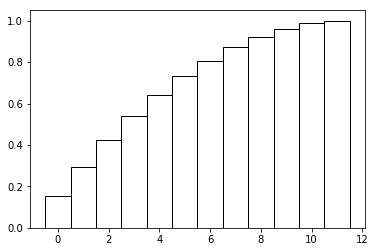

In [31]:
# compare to cumulative distribution chart on p339
cumulative_distribution = weights.cumsum()
plt.bar(np.arange(len(weights)), cumulative_distribution, color='white', edgecolor=['black'] * len(weights), width=1)

In [32]:
def get_cumulative_distribution_index(cumulative_distribution, value):
    return np.argmax(cumulative_distribution > value)

In [33]:
get_cumulative_distribution_index(cumulative_distribution, 0.1)

0

In [34]:
get_cumulative_distribution_index(cumulative_distribution, 0.2)

1

In [35]:
get_cumulative_distribution_index(cumulative_distribution, 0.99)

11

_Generate melody of favoring pitches at the low end of the chromatic scale:_

In [36]:
from pitches import NOTE_NAMES

chromatic_note_names = NOTE_NAMES + [NOTE_NAMES[0] + '1'] # wrap around to the first note of the next octave
chromatic_note_names

['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B', 'C1']

In [37]:
indices = [get_cumulative_distribution_index(cumulative_distribution, prob) for prob in np.random.rand(25)]
melody = np.array(chromatic_note_names)[indices]
melody

array(['C#', 'A#', 'E', 'C#', 'C#', 'E', 'G', 'D', 'A', 'G#', 'C#', 'G#',
       'C', 'E', 'F#', 'C#', 'D#', 'G', 'A', 'C', 'D', 'C', 'E', 'E', 'E'],
      dtype='<U2')

In [38]:
render_notes_ipython(note_labels_for_pitch_numbers(transpose_pitch_numbers(pitch_numbers_for_note_labels(melody), 4 * SEMITONES_IN_OCTAVE)))

_Select from a rising set of probability distributions to make a rising and falling melody:_

In [39]:
rising_distributions = np.array([
    [1,0,0,0,0,0,0,0,0,0,0,0,0],
    [0,1,1,1,1,1,0,0,0,0,0,0,0],
    [0,0,0,0,0,0,1,1,1,1,1,1,0],
    [0,0,0,0,0,0,0,0,0,0,0,0,1],
])
rising_distributions = rising_distributions / rising_distributions.sum(axis=1, keepdims=True)
rising_distributions = rising_distributions.cumsum(axis=1)

num_notes = 25

def distribution_index_for_note_number(note_number, num_notes):
    high_point = int(num_notes * 2.0/3.0)
    progress = note_number / num_notes
    if note_number == 0 or note_number == num_notes - 1:
        return 0
    elif progress < 0.3:
        return 1
    elif progress < 0.6:
        return 2
    elif note_number == high_point:
        return 3
    elif progress < 0.8:
        return 2
    else:
        return 1

melody = []
for i in range(num_notes):
    distribution = rising_distributions[distribution_index_for_note_number(i, num_notes), :]
    index = get_cumulative_distribution_index(distribution, np.random.rand())
    melody.append(chromatic_note_names[index])
print(melody)

['C', 'F', 'E', 'D#', 'F', 'C#', 'F', 'F', 'A#', 'A', 'B', 'A#', 'G', 'A', 'F#', 'A#', 'C1', 'A', 'F#', 'A#', 'E', 'E', 'E', 'C#', 'C']


In [40]:
render_notes_ipython(note_labels_for_pitch_numbers(transpose_pitch_numbers(pitch_numbers_for_note_labels(melody), 4 * SEMITONES_IN_OCTAVE)))

## Self-Similarity

### Weierstrass function

The book mentions the Weierstrass function and its power spectrum. The [Weierstrass function](https://en.wikipedia.org/wiki/Weierstrass_function) is continuous everywhere but differentiable nowhere. Here is the definition:

$f(x) = \sum_\limits{n=0}^\limits{\infty}a^n\cos{(b^n\pi x)}$,

where $0<a<1$, $b$ is a positive odd integer, and

$ab>1+{\frac{3}{2}}\pi$.

Here I reproduce the animation on its Wikipedia page, showing increasing $b$ values:

In [41]:
sum_range = np.arange(10)
def weierstrass(x, a=0.5, b=5):
    return ((a**sum_range).reshape(-1, 1) * np.cos(np.outer(b**sum_range * np.pi, x))).sum(axis=0)

In [42]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

from matplotlib import animation
from IPython.display import HTML

x = np.linspace(-5, 5, 1000)
weierstrass_plot = plt.subplot(2, 1, 1)
power_spectrum_plot = plt.subplot(2, 1, 2)
weierstrass_plot.figure.set_size_inches(10, 8)
y = weierstrass(x)
weierstrass_ax, = weierstrass_plot.plot(x, y)

weierstrass_plot.set_title('Weierstass Function', size=14)
weierstrass_plot.set_xlim([x.min(), x.max()])
weierstrass_plot.set_ylim([-3, 3]) # emulating plot on p351 of the book

power_spectrum = np.abs(np.fft.fft(y)) ** 2
power_spectrum /= power_spectrum.max()
freqs = np.fft.fftfreq(y.size, 1)
freqs_idx = np.argsort(freqs)
freqs_idx = freqs_idx[freqs_idx.size // 2:]
power_spectrum_ax, = power_spectrum_plot.loglog(power_spectrum[freqs_idx])
power_spectrum_plot.set_yticks([0.001, 0.01, 0.1, 1.0])
power_spectrum_plot.set_ylim(0.0001, 1.0)
power_spectrum_plot.set_title('Power Spectrum', size=14)

frames_per_sec = 24
num_frames = frames_per_sec * 6

def animate(i):
    y = weierstrass(x, b=(i/num_frames) * 5)
    weierstrass_ax.set_ydata(y)

    power_spectrum = np.abs(np.fft.fft(y)) ** 2
    power_spectrum /= power_spectrum.max()
    power_spectrum_ax.set_ydata(power_spectrum[freqs_idx])

anim = animation.FuncAnimation(weierstrass_plot.figure, animate, frames=num_frames, interval=1_000/frames_per_sec)
plt.close()
HTML(anim.to_html5_video())

The log-log power spectrum plot is intended to show the roughly $1/f$ power dropoff.  We say that the Weierstrass function has a _spectral tendency_ of $1/f$.  This matches the average spectral tendency of many forms of popular music, indicating heirarchical self-similarity in musical structures.

The author describes the sound of the Weierstrass function as sounding "like a rich pipe organ tone." Let's hear it at various values of `b`!

In [43]:
from NoteSequence import render_samples_ipython
from conversion import SAMPLES_PER_SECOND
from AR import AR

# remove clicks
envelope = AR(attack_seconds=0.03, release_seconds=0.025)

x = np.linspace(-5, 5, SAMPLES_PER_SECOND)
w = np.concatenate([envelope.apply(weierstrass(x, b=b)) for b in range(1, 12)])
w /= w.max()
render_samples_ipython(w)

### Brownian Noise and Random Walk

_Brownian noise_ is produced by _Brownian motion_, otherwise known as a random walk.

At each step, a new position is calculated from a random uniform distribution.  Thus, Brownian noise is also the integral of uniform noise.

Text(0.5,1,'Uniform noise')

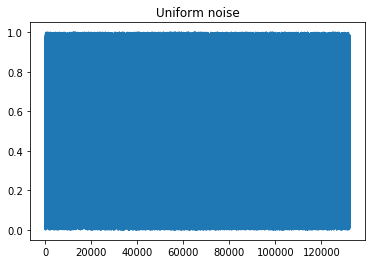

In [44]:
uniform_noise = np.random.rand(SAMPLES_PER_SECOND * 3)
plt.plot(uniform_noise)
plt.title('Uniform noise')

Text(0.5,1,'Uniform noise power spectrum')

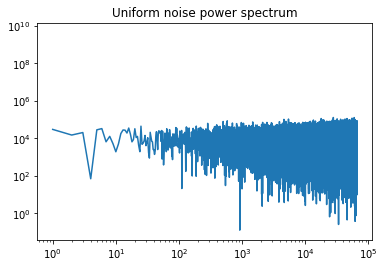

In [45]:
un_power_spectrum = np.abs(np.fft.fft(uniform_noise)) ** 2
plt.loglog(un_power_spectrum[:un_power_spectrum.size // 2])
plt.title('Uniform noise power spectrum')

**White noise audio**

In [46]:
AR(0.5, 0.3).apply(uniform_noise)
render_samples_ipython(uniform_noise)

Text(0.5,1,'Brownian noise')

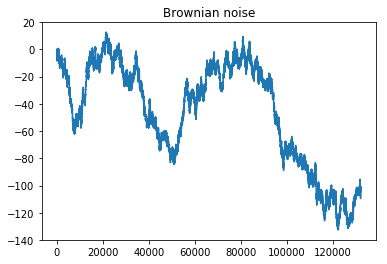

In [47]:
brownian_noise = (np.random.rand(SAMPLES_PER_SECOND * 3) - 0.5).cumsum()
plt.plot(brownian_noise)
plt.title('Brownian noise')

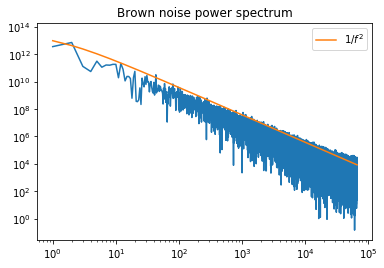

In [48]:
bn_power_spectrum = np.abs(np.fft.fft(brownian_noise)) ** 2
plt.loglog(bn_power_spectrum[:bn_power_spectrum.size // 2])
plt.plot(bn_power_spectrum.max()/(np.arange(1, bn_power_spectrum.size // 2) ** 2), label="$1/f^2$")
plt.title('Brown noise power spectrum')
plt.legend()

_Note that the frequency tendency here follows roughly a $1/f^2$ line - not the $1/f$ tendency we're searching for._

**Brown noise audio**

In [49]:
AR(0.5, 0.3).apply(brownian_noise)
render_samples_ipython(brownian_noise) # `render_samples` normalizes

### Fractional Brownian Motion

_Fractional Brownian motion_ is like Brownian motion, but the increments are not independent.  Local rapidly fluctuating values are influenced by slower-moving values extending proportionately over the entire spectrum. As fBm is magnified, it retains its statistically self-similar shape, and so it is fractal regardless of magnification (unline regular Brownian motion which loses self-similarity at scale).

Fractional Brownian noise sounds the same regardless of playback speed, since the signal and the spectrum are self-similar at all levels of scale.

**Voss's Method**

The basic method here is to sum multiple normal random variables that each change at a rate twice as fast as the previous one.

Quoting from the book: _"Random values in the rapidly changing functions have only local influence, whereas values in the slowly changing functions extend their influence over many samples of the summed result, giving the result a fractal characteristic."_

In [50]:
# from p358
def voss_fractal_rand(n, random_variables):
    total = 0
    for k in range(len(random_variables)):
        if n % 2 ** k == 0:
            random_variables[k] = np.random.rand() * 2 - 1
        total += random_variables[k]
    return total

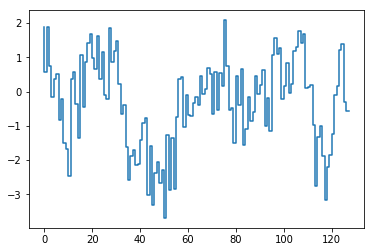

In [51]:
random_variables = np.random.rand(20)
samples = [voss_fractal_rand(n, random_variables) for n in range(128)]
plt.plot(samples, drawstyle='steps-pre')

In [52]:
voss_noise = np.array([voss_fractal_rand(n, random_variables) for n in range(SAMPLES_PER_SECOND * 8)])

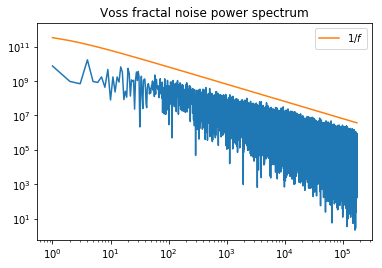

In [53]:
voss_power_spectrum = np.abs(np.fft.fft(voss_noise)) ** 2
plt.loglog(voss_power_spectrum[:voss_power_spectrum.size // 2])
plt.plot(voss_power_spectrum.max()/(np.arange(1, voss_power_spectrum.size // 2)), label="$1/f$")
plt.title('Voss fractal noise power spectrum')
plt.legend()

... sounds roughly the same at various sample rates:

_(I'm generating a lot of extra audio and oversampling since the self-similarity obviously won't apply at the sub-sample level.  We should be able to "zoom in" to a smaller section and have it sound the same, so I'm generating audio for 4X as much time as we need.)_

In [54]:
render_samples_ipython(AR(0.2, 0.125).apply(voss_noise.copy()[:voss_noise.size // 4]), rate=SAMPLES_PER_SECOND)

In [55]:
render_samples_ipython(AR(0.4, 0.25).apply(voss_noise.copy()[:voss_noise.size // 2]), rate=SAMPLES_PER_SECOND * 2)

I'm pretty convinced! At first the 4X sample rate was generating a clearly higher-pitched average sound, but after experimenting with adding more random variables, this turned out to be the key (since its estimation will be better as $n$ approaches infinity).

I don't provide varying numbers of random variable audio output here for space, but I recommend trying for yourself!

In [56]:
render_samples_ipython(AR(0.8, 0.5).apply(voss_noise.copy()), rate=SAMPLES_PER_SECOND * 4)

### Monte Carlo Methods

The subject isn't explored in detail in the text. [Here is a performance](https://youtu.be/fojKZ1ymZlo) of a computer-generated composition, called the Illiac Suite, from 1959 by Lejaren Hiller and Leonard Isaacson, using a monte carlo method guided by metrics for measuring compositional merit.  Please refer to the text for a full description of their methodology (p361-362).



## Markov Chains

In [57]:
oh_susanna_pitches = list('FFAAAGGECDCDEGGAGECDEEDDC')
# transpose to reasonable range
oh_susanna_pitches = np.array([pitch + '4' for pitch in oh_susanna_pitches])
oh_susanna_rhythm = np.array([1, 1, 1/2, 1, 1/2, 1/2, 1/2, 1/2, 1/2, 3/2, 1/4, 1/4, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 1/2, 2]) * 0.5

render_notes_ipython(list(zip(oh_susanna_pitches, oh_susanna_rhythm)))

In [70]:
import pandas as pd

unique_pitches = np.unique(oh_susanna_pitches)
markov_df = pd.DataFrame(0.0, index=unique_pitches, columns=unique_pitches)

# create frequency chart where cell [row, column] shows how many times
# the pitch at `column` follows the pitch at `row`
for pitch in unique_pitches:
    next_indices = np.where(oh_susanna_pitches == pitch)[0] + 1
    next_indices = np.delete(next_indices, np.where(next_indices >= oh_susanna_pitches.size))
    for next_pitch in oh_susanna_pitches[next_indices]:
        markov_df.loc[pitch][next_pitch] += 1

# normalize for probability distribution
markov_df = markov_df.div(markov_df.sum(axis=1), axis=0)
# turn into cumulative distribution
markov_df = markov_df.cumsum(axis=1)

In [71]:
markov_df
# compare to Table 9.11 on p366
# (noting the difference in row/column order presentation)

,A4,C4,D4,E4,F4,G4
A4,0.5,0.5,0.5,0.5,0.5,1.0
C4,0.0,0.0,1.0,1.0,1.0,1.0
D4,0.0,0.4,0.6,1.0,1.0,1.0
E4,0.0,0.4,0.6,0.8,0.8,1.0
F4,0.5,0.5,0.5,0.5,1.0,1.0
G4,0.2,0.2,0.2,0.6,0.6,1.0


In [72]:
import warnings
warnings.filterwarnings('ignore')
# defined earlier in this notebook
get_cumulative_distribution_index(markov_df.loc['D4'], 0.0)

'C4'

In [73]:
get_cumulative_distribution_index(markov_df.loc['D4'], 0.99)

'E4'

In [77]:
first_order_markov_pitches = [oh_susanna_pitches[0]]
for i in range(1, oh_susanna_pitches.size):
    next_pitch = get_cumulative_distribution_index(markov_df.loc[first_order_markov_pitches[i - 1]], np.random.rand())
    first_order_markov_pitches.append(next_pitch)

**First-order Markov generated Oh Susanna remix:**

In [78]:
render_notes_ipython(list(zip(first_order_markov_pitches, oh_susanna_rhythm)))

For more exploration of Markov chain composition, I have a [blog post](https://karlhiner.com/music_generation/midi_markov/) with links to some interesting compositions that came out of my experimentation, along with a Ruby program for generating MIDI streams using Markov chains.